# HackerRank Developer Survey 2018 Analysis

HackerRank conducted a survey of developers late in 2016 and got an astounding 25K responses. The survey asked developers many questions around their skills, educational background, current role, hiring practices and more. I got this dataset from [kaggle](kaggle.com). I am going to do an exploratory analysis on this dataset and make comparison between men and women working as developers according to their jobs, positions, coding interests and preferences. I will focus more on understanding trends about women pursuing careers as developers. I will be implementing the data analytics and data visualisation techniques that I learned in from the course [Data Analysis with Python: Zero to Pandas](zerotopandas.com) in this project.

## Downloading the Dataset

We'll use the HackerRank developer survey 2018 dataset for our analysis. You can find the raw data here: [https://www.kaggle.com/hackerrank/developer-survey-2018](https://www.kaggle.com/hackerrank/developer-survey-2018)

In [1]:
import pandas as pd

The dataset has been downloaded and extracted.

In [2]:
import os
os.listdir()

['.ipynb_checkpoints',
 '.jovianrc',
 'Codebook.csv',
 'Country-Code-Mapping.csv',
 'hackerrank-developer-survey-analysis.ipynb',
 'Numeric-Mapping.csv',
 'Numeric.csv',
 'Values.csv']

In [3]:
df4=pd.read_csv('Values.csv',low_memory=False)

In [4]:
Ques_bank_df = pd.read_csv('Codebook.csv')

Let us save and upload our work to Jovian before continuing.

In [5]:
project_name = "hackerrank-developer-survey-analysis" 

In [6]:
!pip install jovian --upgrade -q

In [7]:
import jovian

In [8]:
jovian.commit(project=project_name)

<IPython.core.display.Javascript object>

[jovian] Attempting to save notebook..
[jovian] Updating notebook "nishumttl770/hackerrank-developer-survey-analysis" on https://jovian.ml/
[jovian] Uploading notebook..
[jovian] Capturing environment..
[jovian] Committed successfully! https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis


'https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis'

## Data Preparation and Cleaning

Let's explore various rows and columns of the datasets used and mold them according to our analysis.

In [9]:
Ques_bank_df.drop('Notes',axis=1,inplace=True)

ques_bank=pd.Series(Ques_bank_df['Survey Question'])
ques_bank.index=Ques_bank_df['Data Field']
ques_bank['q5DegreeFocus']

'What is the focus area of your degree?'

`pandas.DataFrame.drop()` removes rows or columns by specifying label names and corresponding axis, or by specifying directly index or column names. When using a multi-index, labels on different levels can be removed by specifying the level.

In [10]:
ques_bank

Data Field
RespondentID                                                                 NaN
StartDate                                                                    NaN
EndDate                                                                      NaN
CountryNumeric2                                                              NaN
q1AgeBeginCoding                                At what age did you start coding
q2Age                                                       How old are you now?
q3Gender                                       What gender do you identify with?
q4Education                    What is the highest level of education you hav...
q0004_other                                               Other (please specify)
q5DegreeFocus                             What is the focus area of your degree?
q0005_other                                               Other (please specify)
q6LearnCodeUni                                    How did you learn how to code?
q6LearnCodeSelfTa

In [11]:
pd.set_option("display.max_rows", 500, "display.max_columns", 252,"max_colwidth",40)

In [12]:
df4

,RespondentID,StartDate,EndDate,CountryNumeric2,q1AgeBeginCoding,q2Age,q3Gender,q4Education,q0004_other,q5DegreeFocus,q0005_other,q6LearnCodeUni,q6LearnCodeSelfTaught,q6LearnCodeAccelTrain,q6LearnCodeDontKnowHowToYet,q6LearnCodeOther,q0006_other,q7Level1,q8JobLevel,q0008_other,q8Student,q9CurrentRole,q0009_other,q10Industry,q0010_other,q12JobCritPrefTechStack,q12JobCritCompMission,q12JobCritCompCulture,q12JobCritWorkLifeBal,q12JobCritCompensation,q12JobCritProximity,q12JobCritPerks,q12JobCritSmartPeopleTeam,q12JobCritImpactwithProduct,q12JobCritInterestProblems,q12JobCritFundingandValuation,q12JobCritStability,q12JobCritProfGrowth,q12JobCritOther,q0012_other,q13EmpMeasWhiteboard,q13EmpMeasHackerRank,q13EmpMeasOtherCodingChallenge,q13EmpMeasTechPhoneInt,q13EmpMeasTakeHomeProject,q13EmpMeasResume,q13EmpMeasPastWork,q13EmpMeasOther,q0013_other,q14GoodReflecAbilities,q15Level2,q16HiringManager,q17HirChaInterviews,q17HirChaHardAssessSkills,q17HirChaNotEnoughTalent,q17HirChaNoDiversCandidates,q17HirChaCompfromCompanies,q17HirChaJobDescript,q17HirChaOther,q0017_other,q18NumDevelopHireWithinNextYear,q19TalToolResumeScreen,q19TalToolReferral,q19TalToolHackerRank,q19TalToolOtherProbSolv,q19TalToolPersTest,q19TalToolRemoteorLiveIntTool,q19TalToolOutsourceHumIntPanel,q19TalToolOther,q0019_other,q20CandYearExp,q20CandCompScienceDegree,q20CandCodingBootcamp,q20CandSkillCert,q20CandHackerRankActivity,q20CandOtherCodingCommAct,q20CandGithubPersProj,q20CandOpenSourceContrib,q20CandHackathonPart,q20CandPrevWorkExp,q20CandPrestigeDegree,q20CandLinkInSkills,q20CandGithubPersProj2,q20Other,q0020_other,q21CoreCompProbSolv,q21CoreCompProgLang,q21CoreCompFrameworkProf,q21CoreCompDebugging,q21CoreCompCodebaseNav,q21CoreCompPerfOpt,q21CoreCompCodeReview,q21CoreCompDatabaseDesign,q21CoreCompSysDesign,q21CoreCompTesting,q22LangProfAgnostic,q22LangProfC,q22LangProfCPlusPlus,q22LangProfJava,q22LangProfPython,q22LangProfRuby,q22LangProfJavascript,q22LangProfCSharp,q22LangProfGo,q22LangProfScala,q22LangProfPerl,q22LangProfSwift,q22LangProfPascal,q22LangProfClojure,q22LangProfPHP,q22LangProfHaskell,q22LangProfLua,q22LangProfR,q22LangProfOther,q0022_other,q23FrameAngularJS,q23FrameReact,q23FrameVueDotJS,q23FrameEmber,q23FrameBackboneDotJS,q23FrameSpring,q23FrameJSF,q23FrameStruts,q23FrameNodeDotJS,q23FrameExpressJS,q23FrameMeteor,q23FrameDjango,q23FramePyramid,q23FrameRubyonRails,q23FramePadrino,q23FrameASP,q23FrameNetCore,q23FrameCocoa,q23FrameReactNative,q23FrameRubyMotion,q23FrameOther,q0023_other,q24VimorEmacs,q0024_other,q25LangC,q25LangCPlusPlus,q25LangJava,q25LangPython,q25LangRuby,q25LangJavascript,q25LangCSharp,q25LangGo,q25Scala,q25LangPerl,q25LangSwift,q25LangPascal,q25LangClojure,q25LangPHP,q25LangHaskell,q25LangLua,q25LangR,q25LangRust,q25LangTypescript,q25LangKotlin,q25LangJulia,q25LangErlang,q25LangOcaml,q25LangOther,q26FrameLearnAngularJS,q26FrameLearnReact,q26FrameLearnVueDotjs,q26FrameLearnEmber,q26FrameLearnBackboneDotjs,q26FrameLearnSpring,q26FrameLearnJSF,q26FrameLearnStruts,q26FrameLearnDjango,q26FrameLearnPyramid,q26FrameLearnRubyonRails,q26FrameLearnPadrino,q26FrameLearnASP,q26FrameLearnNetCore,q26FrameLearnNodeDotjs,q26FrameLearnExpressJS,q26FrameLearnMetero,q26FrameLearnCocoa,q26FrameLearnReactNative,q26FrameLearnRubyMotion,q26FrameLearnPadrino2,q26FrameLearnDjango2,q26FrameLearnPyramid2,q0026_other,q27EmergingTechSkill,q0027_other,q28LoveC,q28LoveCPlusPlus,q28LoveJava,q28LovePython,q28LoveRuby,q28LoveJavascript,q28LoveCSharp,q28LoveGo,q28LoveScala,q28LovePerl,q28LoveSwift,q28LovePascal,q28LoveClojure,q28LovePHP,q28LoveHaskell,q28LoveLua,q28LoveR,q28LoveRust,q28LoveKotlin,q28LoveTypescript,q28LoveErlang,q28LoveJulia,q28LoveOCaml,q28LoveOther,q29FrameLoveAngularJS,q29FrameLoveReact,q29FrameLoveVuedotjs,q29FrameLoveEmber,q29FrameLoveBackboneDotjs,q29FrameLoveSpring,q29FrameLoveJSF,q29FrameLoveStruts,q29FrameLoveDjango,q29FrameLovePyramid,q29FrameLoveRubyonRails,q29FrameLovePadrino,q29FrameLoveASP,q29FrameLoveNetCore,q29FrameLoveNodeDotj

The dataset contains over 25,090 responses to 36 questions (although many questions are optional). There's no personally identifiable information available to us, although each respondent has been assigned a randomized respondentID.

In [13]:
df4.columns

Index(['RespondentID', 'StartDate', 'EndDate', 'CountryNumeric2',
       'q1AgeBeginCoding', 'q2Age', 'q3Gender', 'q4Education', 'q0004_other',
       'q5DegreeFocus',
       ...
       'q30LearnCodeOther', 'q0030_other', 'q31Level3',
       'q32RecommendHackerRank', 'q0032_other', 'q33HackerRankChallforJob',
       'q34PositiveExp', 'q34IdealLengHackerRankTest', 'q0035_other',
       'q36Level4'],
      dtype='object', length=251)

While the survey responses contain a lot of information, we'll limit our analysis to the following few areas:

- Demographics of the survey respondents & the global programming community
- Distribution of programming skills, experience and preferences
- General opinion about the website

Let's select a subset of columns with the relevant data for our analysis.

In [14]:
selected_columns=[ #Demographics
                  'CountryNumeric2',
                  'q1AgeBeginCoding', 
                  'q3Gender',
                  'q5DegreeFocus',
                  'q9CurrentRole',
                  'q10Industry',
                  'q0010_other',
                   #Programming experience
                  'q25LangC',
                  'q25LangCPlusPlus',
                  'q25LangJava',
                  'q25LangPython',
                  'q25LangRuby',
                  'q25LangJavascript',
                  'q25LangCSharp',
                  'q25LangGo',
                  'q25Scala',
                  'q25LangPerl',
                  'q25LangSwift',
                  'q25LangPascal',
                  'q25LangClojure',
                  'q25LangPHP',
                  'q25LangHaskell',
                  'q25LangLua',
                  'q25LangR',
                  'q25LangRust',
                  'q25LangTypescript',
                  'q25LangKotlin',
                  'q25LangJulia',
                  'q25LangErlang',
                  'q25LangOcaml',
                  'q25LangOther',
                  'q26FrameLearnAngularJS',
                  'q26FrameLearnReact',
                  'q26FrameLearnVueDotjs',
                  'q26FrameLearnEmber',
                  'q26FrameLearnBackboneDotjs',
                  'q26FrameLearnSpring',
                  'q26FrameLearnJSF',
                  'q26FrameLearnStruts',
                  'q26FrameLearnDjango',
                  'q26FrameLearnPyramid',
                  'q26FrameLearnRubyonRails',
                  'q26FrameLearnPadrino',
                  'q26FrameLearnASP',
                  'q26FrameLearnNetCore',
                  'q26FrameLearnNodeDotjs',
                  'q26FrameLearnExpressJS',
                  'q26FrameLearnMetero',
                  'q26FrameLearnCocoa',
                  'q26FrameLearnReactNative',
                  'q26FrameLearnRubyMotion',
                  'q26FrameLearnPadrino2',
                  'q26FrameLearnDjango2',
                  'q26FrameLearnPyramid2',
                   #General opinion
                  'q32RecommendHackerRank'
]

In [15]:
survey_df=df4[selected_columns].copy()
survey_df

,CountryNumeric2,q1AgeBeginCoding,q3Gender,q5DegreeFocus,q9CurrentRole,q10Industry,q0010_other,q25LangC,q25LangCPlusPlus,q25LangJava,q25LangPython,q25LangRuby,q25LangJavascript,q25LangCSharp,q25LangGo,q25Scala,q25LangPerl,q25LangSwift,q25LangPascal,q25LangClojure,q25LangPHP,q25LangHaskell,q25LangLua,q25LangR,q25LangRust,q25LangTypescript,q25LangKotlin,q25LangJulia,q25LangErlang,q25LangOcaml,q25LangOther,q26FrameLearnAngularJS,q26FrameLearnReact,q26FrameLearnVueDotjs,q26FrameLearnEmber,q26FrameLearnBackboneDotjs,q26FrameLearnSpring,q26FrameLearnJSF,q26FrameLearnStruts,q26FrameLearnDjango,q26FrameLearnPyramid,q26FrameLearnRubyonRails,q26FrameLearnPadrino,q26FrameLearnASP,q26FrameLearnNetCore,q26FrameLearnNodeDotjs,q26FrameLearnExpressJS,q26FrameLearnMetero,q26FrameLearnCocoa,q26FrameLearnReactNative,q26FrameLearnRubyMotion,q26FrameLearnPadrino2,q26FrameLearnDjango2,q26FrameLearnPyramid2,q32RecommendHackerRank
0,South Korea,16 - 20 years old,Female,Computer Science,Student,NaN,student,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
1,Ukraine,16 - 20 years old,Male,"Other STEM (science, technology, eng...",Software Test Engineer,Financial Services,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
2,Malaysia,11 - 15 years old,Female,"Other STEM (science, technology, eng...",Student,Education,NaN,Will Learn,Will Learn,Will Learn,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
3,Curaçao,11 - 15 years old,Male,Computer Science,Student,NaN,student,NaN,Know,Will Learn,Will Learn,Know,Will Learn,Know,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
4,NaN,16 - 20 years old,Female,NaN,Front-end Developer,Technology,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,Will Learn,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,Yes
5,United States,41 - 50 years old,Male,Computer Science,NaN,Technology,NaN,Will Learn,Will Learn,Know,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
6,United States,16 - 20 years old,Male,Computer Science,Unemployed,Financial Services,NaN,Know,Know,Will Learn,Will Learn,NaN,Know,Will Learn,NaN,NaN,Know,NaN,Know,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
7,United States,16 - 20 years old,Male,"Other STEM (science, technology, eng...",NaN,Education,NaN,NaN,Know,NaN,Know,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [16]:
survey_df.replace(to_replace='#NULL!',value='Unknown',inplace=True)

`pandas.DataFrame.replace()` replaces values in dataframe given in <i>to_replace</i> with <i>value</i> dynamically.

In [17]:
#jovian.commit()

## Exploratory Analysis and Visualization

Before getting down to asking some interesting questions about the survey responses, it would help us to understand what the demographics i.e. age, gender, degree focus, current role etc. of the respondents look like. It's important to explore these variables in order to understand how representative this survey is of the worldwide programming community, as this survey is of large scale and can have some selection bias.

Let's begin by importing`matplotlib.pyplot` and `seaborn`.

In [18]:
import seaborn as sns
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (9, 5)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

## Gender 
We should now look at the distribution of responses for the Gender using `q3Gender` column. It is very well known that women and non-binary genders are underrepresented in the programming community, so we might expect to see a skewed distribution here.

In [19]:
gender_sum=survey_df[(survey_df['q3Gender']=='Male') | (survey_df['q3Gender']=='Female')].q3Gender.value_counts().sum()

`pandas.Series.value_counts()` returns a Series containing counts of unique values. The resulting object will be in descending order so that the first element is the most frequently occurring element. Excludes NA values by default.

In [20]:
other_genders=survey_df['q3Gender'].value_counts().sum()-gender_sum
other_genders

194

In [21]:
gender_distribution=survey_df[(survey_df['q3Gender']=='Male') | (survey_df['q3Gender']=='Female')].q3Gender.value_counts()
gender_distribution['Other']=other_genders
gender_distribution

Male      20774
Female     4122
Other       194
Name: q3Gender, dtype: int64

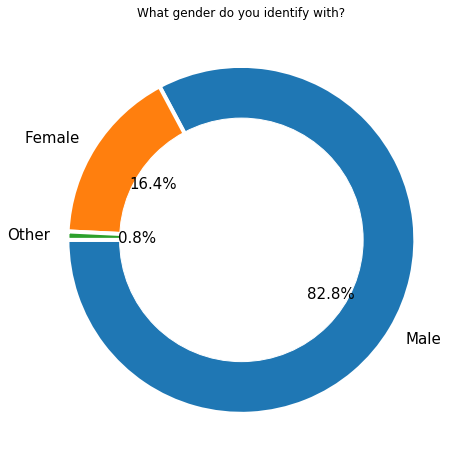

In [22]:
plt.figure(figsize=(15,8))
plt.title(ques_bank['q3Gender'])
matplotlib.rcParams['font.size']=15
my_circle=plt.Circle( (0,0),0.7, color='white')
plt.pie(gender_distribution, labels=gender_distribution.index, autopct='%1.1f%%',startangle=180,wedgeprops = { 'linewidth' : 4, 'edgecolor' : 'white' },explode=(0,0,0))
p=plt.gcf()
p.gca().add_artist(my_circle);

We can clearly see that there are a lot more male respondents as compared to female ones.

`matplotlib.pyplot.pie(x)` plots a pie chart of array x. The fractional area of each wedge is given by x/sum(x). If sum(x) < 1, then the values of x give the fractional area directly and the array will not be normalized. The resulting pie will have an empty wedge of size 1 - sum(x). The wedges are plotted counterclockwise, by default starting from the x-axis.

`matplotlib.patches.Circle()` (A circle patch) creates a true circle at center xy = (x, y) with given radius.

## Current Role
`q9CurrentRole` column holds information related to the current roles of the people in their job.

In [23]:
survey_df['q9CurrentRole'].fillna('Unknown',inplace=True)
current_roles=survey_df['q9CurrentRole'].value_counts()
current_roles

Student                            8005
Software Engineer                  4482
Full-stack Developer               3498
Back-end Developer                 1922
Unknown                            1035
Web Developer                      1032
Front-end Developer                1006
Mobile Developer                    812
Software Architect                  643
Data Scientist                      485
Software Test Engineer              454
Unemployed                          382
Data Analyst                        349
Development Operations Engineer     251
Data Engineer                       216
Software Specialist                 148
Platform Engineer                   129
Network Administrator                98
Reliability Engineer                 76
Database Administrator               67
Name: q9CurrentRole, dtype: int64

`pandas.DataFrame.fillna()` fills NA/NaN values using the specified value.

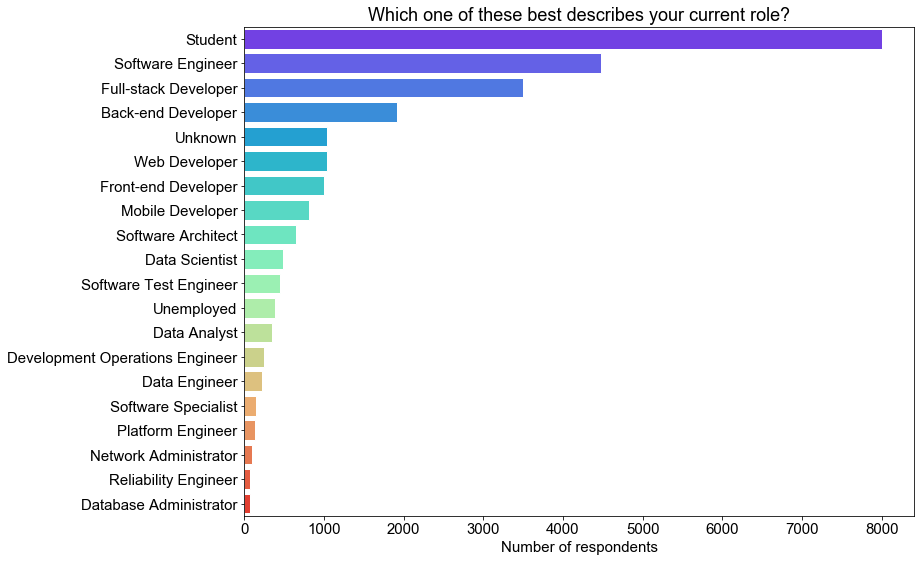

In [24]:
plt.figure(figsize=(12,9))
plt.title(ques_bank['q9CurrentRole'])
sns.set_style('whitegrid')
ax=sns.barplot(current_roles,current_roles.index,palette='rainbow')
ax.set( xlabel = "Number of respondents");

Most of the respondents of this survey are students and then other roles are occupied by less people in comparison to that.

In [25]:
female_roles=survey_df[survey_df['q3Gender']=='Female']['q9CurrentRole'].value_counts()
female_roles=female_roles*100/female_roles.sum()
female_roles

Student                            42.940320
Software Engineer                  15.089762
Full-stack Developer                9.024745
Back-end Developer                  5.676856
Web Developer                       4.949054
Unknown                             4.754973
Front-end Developer                 4.585153
Software Test Engineer              2.620087
Mobile Developer                    2.134886
Unemployed                          1.989326
Data Analyst                        1.746725
Data Scientist                      1.673945
Software Architect                  0.703542
Data Engineer                       0.582242
Development Operations Engineer     0.460941
Software Specialist                 0.315381
Database Administrator              0.242601
Platform Engineer                   0.242601
Reliability Engineer                0.145560
Network Administrator               0.121300
Name: q9CurrentRole, dtype: float64

In [26]:
male_roles=survey_df[survey_df['q3Gender']=='Male']['q9CurrentRole'].value_counts()
male_roles=male_roles*100/male_roles.sum()
male_roles

Student                            29.763165
Software Engineer                  18.407625
Full-stack Developer               14.932127
Back-end Developer                  8.067777
Unknown                             3.956869
Web Developer                       3.952055
Front-end Developer                 3.903918
Mobile Developer                    3.465871
Software Architect                  2.941176
Data Scientist                      1.963993
Software Test Engineer              1.641475
Unemployed                          1.429672
Data Analyst                        1.333398
Development Operations Engineer     1.092712
Data Engineer                       0.904977
Software Specialist                 0.640223
Platform Engineer                   0.572831
Network Administrator               0.438048
Reliability Engineer                0.317705
Database Administrator              0.274381
Name: q9CurrentRole, dtype: float64

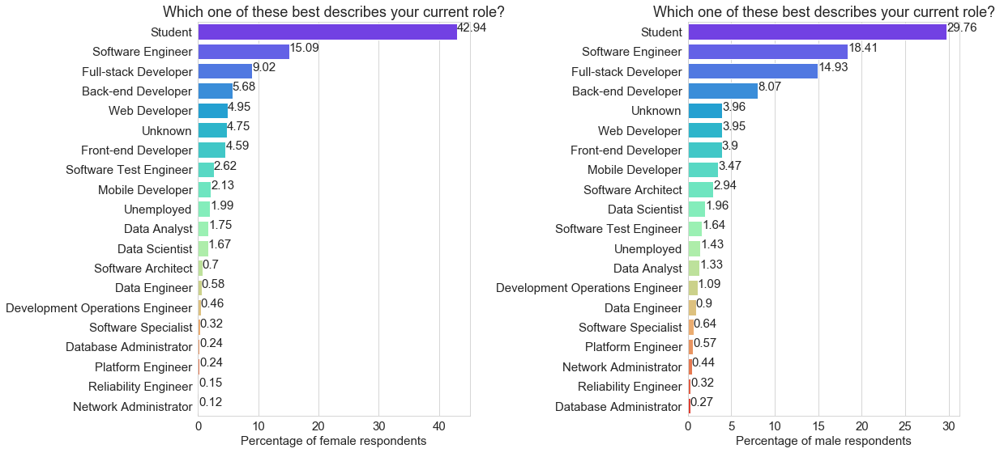

In [27]:
fig, axes = plt.subplots(1,2,figsize=(17,8))
sns.barplot(female_roles,female_roles.index,palette='rainbow', ax=axes[0])
axes[0].set_xlabel("Percentage of female respondents")
for index, value in enumerate(female_roles):
    val=round(value,2)
    axes[0].text(value, index, str(val))
axes[0].set_title(ques_bank['q9CurrentRole']);

sns.barplot(male_roles,male_roles.index,palette='rainbow', ax=axes[1])
axes[1].set_xlabel("Percentage of male respondents")
for index, value in enumerate(male_roles):
    val=round(value,2)
    axes[1].text(value, index, str(val))
axes[1].set_title(ques_bank['q9CurrentRole']);

plt.tight_layout(pad=1)

We can see that a larger percentage of female respondents are students in comparison to male respondents. 

We can also observe a larger percentage of male respondents work as Full-Stack Developers and Software Engineers in comparison to female respondents. But since there is a significant amount of 'Unknown' or unavailable values, we can't assume it is the actual scenario.

`matplotlib.pyplot.subplots()` creates a figure and a set of subplots. This utility wrapper makes it convenient to create common layouts of subplots, including the enclosing figure object, in a single call.

## At what age did you start coding?
`q1AgeBeginCoding` column gives information about the age group of the respondent when he/she started to code.

In [28]:
new_survey_df=survey_df[(survey_df['q3Gender']!='Non-Binary') & (survey_df['q3Gender']!='Unknown')]
new_survey_df=new_survey_df.replace(to_replace=np.nan,value='#NULL!')
new_survey_df['q1AgeBeginCoding'].value_counts()

16 - 20 years old     14200
11 - 15 years old      5220
21 - 25 years old      3607
5 - 10 years old        919
26 - 30 years old       636
31 - 35 years old       192
36 - 40 years old        66
41 - 50 years old        34
Unknown                  16
50+ years or older        6
Name: q1AgeBeginCoding, dtype: int64

In [29]:
ques_bank['q1AgeBeginCoding']

'At what age did you start coding'

In [30]:
new_survey_df['q1AgeBeginCoding'].value_counts().index

Index(['16 - 20 years old', '11 - 15 years old', '21 - 25 years old',
       '5 - 10 years old', '26 - 30 years old', '31 - 35 years old',
       '36 - 40 years old', '41 - 50 years old', 'Unknown',
       '50+ years or older'],
      dtype='object')

In [31]:
new_survey_df['q1AgeBeginCoding'].value_counts()

16 - 20 years old     14200
11 - 15 years old      5220
21 - 25 years old      3607
5 - 10 years old        919
26 - 30 years old       636
31 - 35 years old       192
36 - 40 years old        66
41 - 50 years old        34
Unknown                  16
50+ years or older        6
Name: q1AgeBeginCoding, dtype: int64

In [32]:
l1=list(new_survey_df['q1AgeBeginCoding'].value_counts().values)
l1.pop()
l1.pop()
l1.pop()

34

In [33]:
l2=list(new_survey_df['q1AgeBeginCoding'].value_counts().index)
l2.pop()
l2.pop()
l2.pop()

'41 - 50 years old'

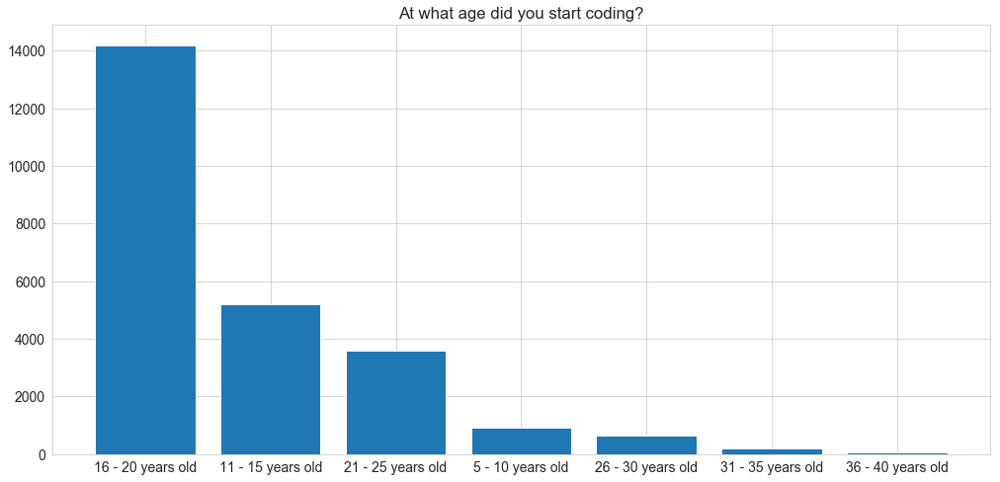

In [34]:
plt.figure(figsize=(17,8))
matplotlib.rcParams['font.size'] = 14
plt.title(ques_bank['q1AgeBeginCoding']+"?")
plt.bar(l2,l1);

According to this survey of 2018, maximum number of people start coding when they are around 16-20 years old.

## Industry
`q10Industry` column contains information about the industry that people work in. This shows the diversity in the use of programming.

In [35]:
survey_df

,CountryNumeric2,q1AgeBeginCoding,q3Gender,q5DegreeFocus,q9CurrentRole,q10Industry,q0010_other,q25LangC,q25LangCPlusPlus,q25LangJava,q25LangPython,q25LangRuby,q25LangJavascript,q25LangCSharp,q25LangGo,q25Scala,q25LangPerl,q25LangSwift,q25LangPascal,q25LangClojure,q25LangPHP,q25LangHaskell,q25LangLua,q25LangR,q25LangRust,q25LangTypescript,q25LangKotlin,q25LangJulia,q25LangErlang,q25LangOcaml,q25LangOther,q26FrameLearnAngularJS,q26FrameLearnReact,q26FrameLearnVueDotjs,q26FrameLearnEmber,q26FrameLearnBackboneDotjs,q26FrameLearnSpring,q26FrameLearnJSF,q26FrameLearnStruts,q26FrameLearnDjango,q26FrameLearnPyramid,q26FrameLearnRubyonRails,q26FrameLearnPadrino,q26FrameLearnASP,q26FrameLearnNetCore,q26FrameLearnNodeDotjs,q26FrameLearnExpressJS,q26FrameLearnMetero,q26FrameLearnCocoa,q26FrameLearnReactNative,q26FrameLearnRubyMotion,q26FrameLearnPadrino2,q26FrameLearnDjango2,q26FrameLearnPyramid2,q32RecommendHackerRank
0,South Korea,16 - 20 years old,Female,Computer Science,Student,NaN,student,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
1,Ukraine,16 - 20 years old,Male,"Other STEM (science, technology, eng...",Software Test Engineer,Financial Services,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
2,Malaysia,11 - 15 years old,Female,"Other STEM (science, technology, eng...",Student,Education,NaN,Will Learn,Will Learn,Will Learn,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
3,Curaçao,11 - 15 years old,Male,Computer Science,Student,NaN,student,NaN,Know,Will Learn,Will Learn,Know,Will Learn,Know,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
4,NaN,16 - 20 years old,Female,NaN,Front-end Developer,Technology,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,Will Learn,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,Yes
5,United States,41 - 50 years old,Male,Computer Science,Unknown,Technology,NaN,Will Learn,Will Learn,Know,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
6,United States,16 - 20 years old,Male,Computer Science,Unemployed,Financial Services,NaN,Know,Know,Will Learn,Will Learn,NaN,Know,Will Learn,NaN,NaN,Know,NaN,Know,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
7,United States,16 - 20 years old,Male,"Other STEM (science, technology, eng...",Unknown,Education,NaN,NaN,Know,NaN,Know,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [36]:
survey_df['q10Industry'].value_counts()

Technology                        10066
Education                          3402
Financial Services                 2129
Retail                              873
Media                               835
Health Care                         699
Unknown                             674
Automotive & Transportation         640
Computer Hardware                   612
Security                            488
Government                          482
Aerospace & Defense                 362
Non-Profit                          304
Insurance                           257
Telecom, Internet Services          179
Food & Beverage                     167
Professional Services               127
Travel, Tourism, Accommodation      117
Energy, Oil, Gas, Utilities          88
Real estate                          39
Manufacturing                        30
Name: q10Industry, dtype: int64

In [37]:
survey_df['q0010_other'].value_counts().sum()

3510

In [38]:
other=survey_df['q10Industry'].value_counts().tail(9).sum()

In [39]:
industries=survey_df['q10Industry'].value_counts().head(12)
industries

Technology                     10066
Education                       3402
Financial Services              2129
Retail                           873
Media                            835
Health Care                      699
Unknown                          674
Automotive & Transportation      640
Computer Hardware                612
Security                         488
Government                       482
Aerospace & Defense              362
Name: q10Industry, dtype: int64

In [40]:
industries.at['Other'] = survey_df['q0010_other'].value_counts().sum()+other
industries.sort_values(ascending=False)

Technology                     10066
Other                           4818
Education                       3402
Financial Services              2129
Retail                           873
Media                            835
Health Care                      699
Unknown                          674
Automotive & Transportation      640
Computer Hardware                612
Security                         488
Government                       482
Aerospace & Defense              362
Name: q10Industry, dtype: int64

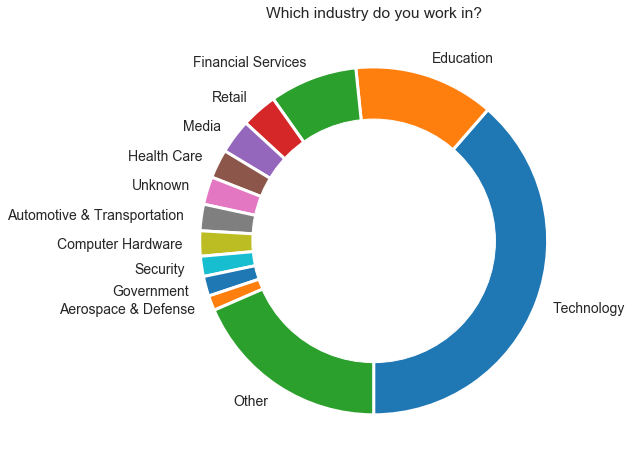

In [41]:
plt.figure(figsize=(12,8))
my_circle=plt.Circle( (0,0), 0.7, color='white')
plt.pie(industries.values, labels=industries.index, wedgeprops = { 'linewidth' : 3, 'edgecolor' : 'white' },startangle=270)
plt.rcParams['font.size'] = 13
p=plt.gcf()
p.gca().add_artist(my_circle)
plt.title('Which industry do you work in?')
plt.show()

In [42]:
ed=3402*100/industries.sum()
fin=2129*100/industries.sum()
tech=10066*100/industries.sum()
print(ed," ",fin," ",tech)

13.044478527607362   8.16334355828221   38.59662576687116


Most people in the programming world are in following industries: Technology( 38.59% ), Education( 13% ) and Financial Services( 8.16% ).

In [43]:
women_ind_df=survey_df[survey_df['q3Gender']=='Female']
other=women_ind_df['q10Industry'].value_counts().tail(8).sum()
w_industries=women_ind_df['q10Industry'].value_counts().head(12)
w_industries.at['Other'] = women_ind_df['q0010_other'].value_counts().sum()+other
w_industries.sort_values(ascending=False)

Technology                     1708
Other                           844
Education                       651
Financial Services              235
Unknown                         176
Media                           111
Retail                           93
Computer Hardware                93
Health Care                      89
Automotive & Transportation      79
Government                       63
Security                         62
Aerospace & Defense              58
Name: q10Industry, dtype: int64

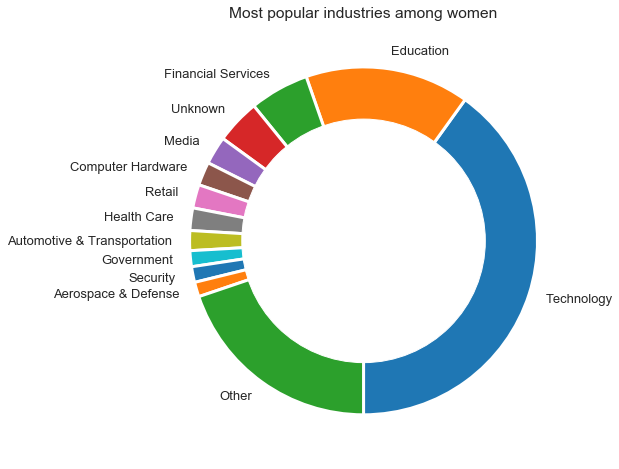

In [44]:
plt.figure(figsize=(12,8))
my_circle=plt.Circle( (0,0), 0.7, color='white')
plt.pie(w_industries.values, labels=w_industries.index, wedgeprops = { 'linewidth' : 3, 'edgecolor' : 'white' },startangle=270)
plt.rcParams['font.size'] = 13
p=plt.gcf()
p.gca().add_artist(my_circle)
plt.title('Most popular industries among women')
plt.show()

In [45]:
ed=651*100/w_industries.sum()
fin=235*100/w_industries.sum()
tech=1708*100/w_industries.sum()
print(ed," ",fin," ",tech)

15.274519005161896   5.513843266072267   40.07508212106992



Women in programming world are working on building softwares across a variety of industries, from technology to Aerospace and Defense.

The most popular industries are: Technology ( 40% ), Education( 15.27% ) and Financial Services( 5.5% )

## What is the focus area of your degree?
It used to be that many female software developers came from a variety of different majors outside of Computer Science and STEM (Science, Technology, Engineering or Math) and men were more likely to take CS than women. Let's see if in 2018, this was indeed the case.

In [46]:
survey_df

,CountryNumeric2,q1AgeBeginCoding,q3Gender,q5DegreeFocus,q9CurrentRole,q10Industry,q0010_other,q25LangC,q25LangCPlusPlus,q25LangJava,q25LangPython,q25LangRuby,q25LangJavascript,q25LangCSharp,q25LangGo,q25Scala,q25LangPerl,q25LangSwift,q25LangPascal,q25LangClojure,q25LangPHP,q25LangHaskell,q25LangLua,q25LangR,q25LangRust,q25LangTypescript,q25LangKotlin,q25LangJulia,q25LangErlang,q25LangOcaml,q25LangOther,q26FrameLearnAngularJS,q26FrameLearnReact,q26FrameLearnVueDotjs,q26FrameLearnEmber,q26FrameLearnBackboneDotjs,q26FrameLearnSpring,q26FrameLearnJSF,q26FrameLearnStruts,q26FrameLearnDjango,q26FrameLearnPyramid,q26FrameLearnRubyonRails,q26FrameLearnPadrino,q26FrameLearnASP,q26FrameLearnNetCore,q26FrameLearnNodeDotjs,q26FrameLearnExpressJS,q26FrameLearnMetero,q26FrameLearnCocoa,q26FrameLearnReactNative,q26FrameLearnRubyMotion,q26FrameLearnPadrino2,q26FrameLearnDjango2,q26FrameLearnPyramid2,q32RecommendHackerRank
0,South Korea,16 - 20 years old,Female,Computer Science,Student,NaN,student,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
1,Ukraine,16 - 20 years old,Male,"Other STEM (science, technology, eng...",Software Test Engineer,Financial Services,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
2,Malaysia,11 - 15 years old,Female,"Other STEM (science, technology, eng...",Student,Education,NaN,Will Learn,Will Learn,Will Learn,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
3,Curaçao,11 - 15 years old,Male,Computer Science,Student,NaN,student,NaN,Know,Will Learn,Will Learn,Know,Will Learn,Know,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
4,NaN,16 - 20 years old,Female,NaN,Front-end Developer,Technology,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,Will Learn,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,Yes
5,United States,41 - 50 years old,Male,Computer Science,Unknown,Technology,NaN,Will Learn,Will Learn,Know,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
6,United States,16 - 20 years old,Male,Computer Science,Unemployed,Financial Services,NaN,Know,Know,Will Learn,Will Learn,NaN,Know,Will Learn,NaN,NaN,Know,NaN,Know,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
7,United States,16 - 20 years old,Male,"Other STEM (science, technology, eng...",Unknown,Education,NaN,NaN,Know,NaN,Know,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [47]:
ques_bank['q5DegreeFocus']

'What is the focus area of your degree?'

In [48]:
degree_focus_df=survey_df[(survey_df['q3Gender']!='Non-Binary') & (survey_df['q3Gender']!='Unknown')]

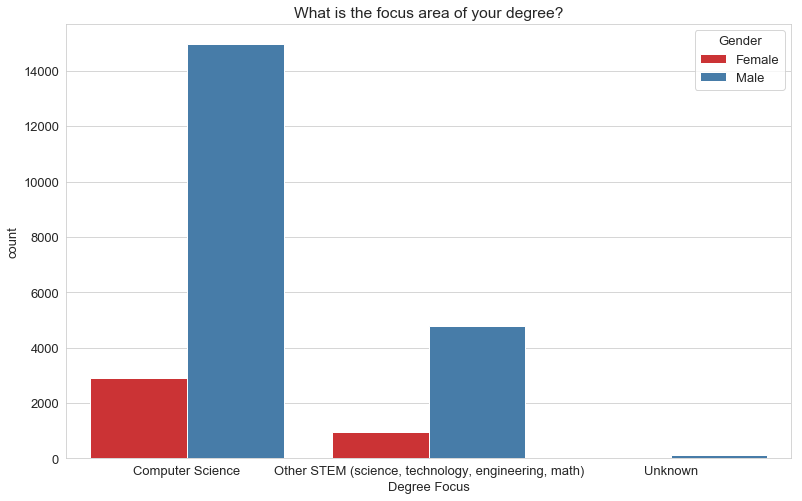

In [49]:
plt.figure(figsize=(13,8))
plt.title('What is the focus area of your degree?')
ax=sns.countplot(x='q5DegreeFocus', hue="q3Gender", data=degree_focus_df,palette='Set1')
ax.set( xlabel = "Degree Focus")
ax.legend().set_title('Gender');

A large number of male respondents have CS degree in comparison to female respondents. Still there is a gap in the number of girls and number of boys from CS background.

`seaborn.countplot()` shows the counts of observations in each categorical bin using bars. A count plot can be thought of as a histogram across a categorical, instead of quantitative, variable. 

## Let us save and upload our work to Jovian before continuing

In [50]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Attempting to save notebook..
[jovian] Updating notebook "nishumttl770/hackerrank-developer-survey-analysis" on https://jovian.ml/
[jovian] Uploading notebook..
[jovian] Capturing environment..
[jovian] Committed successfully! https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis


'https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis'

## Asking and Answering Questions

We have already gained several insights about the respondents and the programming community in general, by exploring various columns of the dataset. Let's ask some good questions, and try to answer them using data frame operations and interesting visualizations.

### Q1: From which country did we get the highest number of responses?
Let's look at the number of countries from which there are responses in the survey and plot the top few countries with the most responses.

In [51]:
top_response_countries=survey_df['CountryNumeric2'].value_counts().head(15)
top_response_countries

India                 8088
United States         4937
Canada                 642
Brazil                 502
United Kingdom         443
Indonesia              387
Russian Federation     378
Germany                258
Turkey                 250
Poland                 248
Ukraine                187
Singapore              183
Mexico                 181
Bangladesh             174
Romania                174
Name: CountryNumeric2, dtype: int64

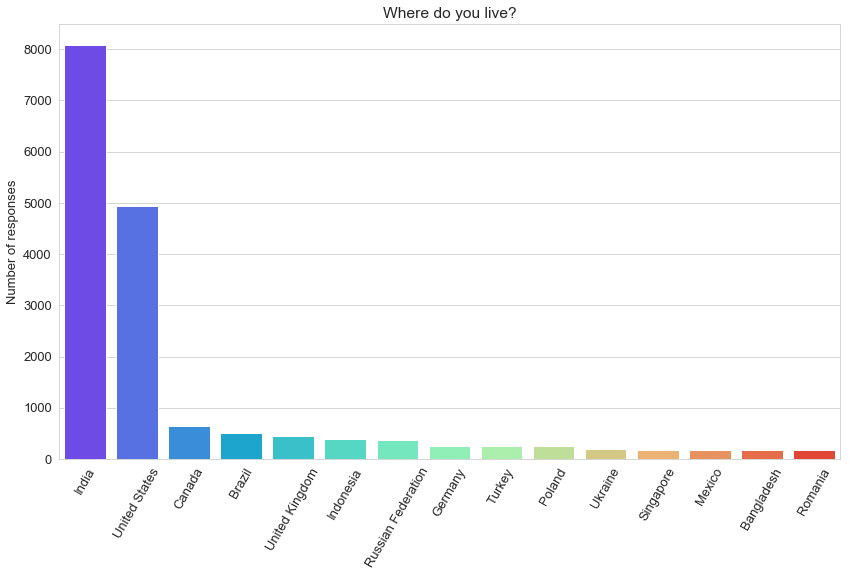

In [52]:
plt.figure(figsize=(14,8))
plt.xticks(rotation=60)
plt.title("Where do you live?")
ax=sns.barplot(top_response_countries.index,top_response_countries,palette='rainbow')
ax.set( ylabel = "Number of responses");

`seaborn.barplot()` shows point estimates and confidence intervals as rectangular bars.
A bar plot represents an estimate of central tendency for a numeric variable with the height of each rectangle and provides some indication of the uncertainty around that estimate using error bars.

Most of the respondents belong to India. United States is the next largest contributer to the survey.

### Q2: Is it necessary to go to a school or university to learn how to code?
Formal education in computer science is considered to be important for a programmer. Let's see if it is the case.
For the answer to this question, let's take a look at the data and notice if there are a significant number of people who learned to code without going to a school or university.

In [53]:
df4

,RespondentID,StartDate,EndDate,CountryNumeric2,q1AgeBeginCoding,q2Age,q3Gender,q4Education,q0004_other,q5DegreeFocus,q0005_other,q6LearnCodeUni,q6LearnCodeSelfTaught,q6LearnCodeAccelTrain,q6LearnCodeDontKnowHowToYet,q6LearnCodeOther,q0006_other,q7Level1,q8JobLevel,q0008_other,q8Student,q9CurrentRole,q0009_other,q10Industry,q0010_other,q12JobCritPrefTechStack,q12JobCritCompMission,q12JobCritCompCulture,q12JobCritWorkLifeBal,q12JobCritCompensation,q12JobCritProximity,q12JobCritPerks,q12JobCritSmartPeopleTeam,q12JobCritImpactwithProduct,q12JobCritInterestProblems,q12JobCritFundingandValuation,q12JobCritStability,q12JobCritProfGrowth,q12JobCritOther,q0012_other,q13EmpMeasWhiteboard,q13EmpMeasHackerRank,q13EmpMeasOtherCodingChallenge,q13EmpMeasTechPhoneInt,q13EmpMeasTakeHomeProject,q13EmpMeasResume,q13EmpMeasPastWork,q13EmpMeasOther,q0013_other,q14GoodReflecAbilities,q15Level2,q16HiringManager,q17HirChaInterviews,q17HirChaHardAssessSkills,q17HirChaNotEnoughTalent,q17HirChaNoDiversCandidates,q17HirChaCompfromCompanies,q17HirChaJobDescript,q17HirChaOther,q0017_other,q18NumDevelopHireWithinNextYear,q19TalToolResumeScreen,q19TalToolReferral,q19TalToolHackerRank,q19TalToolOtherProbSolv,q19TalToolPersTest,q19TalToolRemoteorLiveIntTool,q19TalToolOutsourceHumIntPanel,q19TalToolOther,q0019_other,q20CandYearExp,q20CandCompScienceDegree,q20CandCodingBootcamp,q20CandSkillCert,q20CandHackerRankActivity,q20CandOtherCodingCommAct,q20CandGithubPersProj,q20CandOpenSourceContrib,q20CandHackathonPart,q20CandPrevWorkExp,q20CandPrestigeDegree,q20CandLinkInSkills,q20CandGithubPersProj2,q20Other,q0020_other,q21CoreCompProbSolv,q21CoreCompProgLang,q21CoreCompFrameworkProf,q21CoreCompDebugging,q21CoreCompCodebaseNav,q21CoreCompPerfOpt,q21CoreCompCodeReview,q21CoreCompDatabaseDesign,q21CoreCompSysDesign,q21CoreCompTesting,q22LangProfAgnostic,q22LangProfC,q22LangProfCPlusPlus,q22LangProfJava,q22LangProfPython,q22LangProfRuby,q22LangProfJavascript,q22LangProfCSharp,q22LangProfGo,q22LangProfScala,q22LangProfPerl,q22LangProfSwift,q22LangProfPascal,q22LangProfClojure,q22LangProfPHP,q22LangProfHaskell,q22LangProfLua,q22LangProfR,q22LangProfOther,q0022_other,q23FrameAngularJS,q23FrameReact,q23FrameVueDotJS,q23FrameEmber,q23FrameBackboneDotJS,q23FrameSpring,q23FrameJSF,q23FrameStruts,q23FrameNodeDotJS,q23FrameExpressJS,q23FrameMeteor,q23FrameDjango,q23FramePyramid,q23FrameRubyonRails,q23FramePadrino,q23FrameASP,q23FrameNetCore,q23FrameCocoa,q23FrameReactNative,q23FrameRubyMotion,q23FrameOther,q0023_other,q24VimorEmacs,q0024_other,q25LangC,q25LangCPlusPlus,q25LangJava,q25LangPython,q25LangRuby,q25LangJavascript,q25LangCSharp,q25LangGo,q25Scala,q25LangPerl,q25LangSwift,q25LangPascal,q25LangClojure,q25LangPHP,q25LangHaskell,q25LangLua,q25LangR,q25LangRust,q25LangTypescript,q25LangKotlin,q25LangJulia,q25LangErlang,q25LangOcaml,q25LangOther,q26FrameLearnAngularJS,q26FrameLearnReact,q26FrameLearnVueDotjs,q26FrameLearnEmber,q26FrameLearnBackboneDotjs,q26FrameLearnSpring,q26FrameLearnJSF,q26FrameLearnStruts,q26FrameLearnDjango,q26FrameLearnPyramid,q26FrameLearnRubyonRails,q26FrameLearnPadrino,q26FrameLearnASP,q26FrameLearnNetCore,q26FrameLearnNodeDotjs,q26FrameLearnExpressJS,q26FrameLearnMetero,q26FrameLearnCocoa,q26FrameLearnReactNative,q26FrameLearnRubyMotion,q26FrameLearnPadrino2,q26FrameLearnDjango2,q26FrameLearnPyramid2,q0026_other,q27EmergingTechSkill,q0027_other,q28LoveC,q28LoveCPlusPlus,q28LoveJava,q28LovePython,q28LoveRuby,q28LoveJavascript,q28LoveCSharp,q28LoveGo,q28LoveScala,q28LovePerl,q28LoveSwift,q28LovePascal,q28LoveClojure,q28LovePHP,q28LoveHaskell,q28LoveLua,q28LoveR,q28LoveRust,q28LoveKotlin,q28LoveTypescript,q28LoveErlang,q28LoveJulia,q28LoveOCaml,q28LoveOther,q29FrameLoveAngularJS,q29FrameLoveReact,q29FrameLoveVuedotjs,q29FrameLoveEmber,q29FrameLoveBackboneDotjs,q29FrameLoveSpring,q29FrameLoveJSF,q29FrameLoveStruts,q29FrameLoveDjango,q29FrameLovePyramid,q29FrameLoveRubyonRails,q29FrameLovePadrino,q29FrameLoveASP,q29FrameLoveNetCore,q29FrameLoveNodeDotj

In [54]:
LearnCode_df=pd.DataFrame(index=df4.index)
for col in df4:
    if col[0:3]=='q6L':
        LearnCode_df[col[11:]]=df4[col].copy()
LearnCode_df

,Uni,SelfTaught,AccelTrain,DontKnowHowToYet,Other
0,School or university,"Self-taught (i.e. books, online)",NaN,NaN,NaN
1,School or university,"Self-taught (i.e. books, online)",NaN,NaN,NaN
2,School or university,NaN,Accelerated training (i.e. bootcamp),NaN,NaN
3,NaN,"Self-taught (i.e. books, online)",NaN,NaN,NaN
4,School or university,"Self-taught (i.e. books, online)",NaN,NaN,NaN
5,School or university,NaN,NaN,NaN,NaN
6,NaN,"Self-taught (i.e. books, online)",NaN,NaN,NaN
7,School or university,NaN,NaN,NaN,NaN
8,NaN,"Self-taught (i.e. books, online)",NaN,NaN,NaN
9,NaN,"Self-taught (i.e. books, online)",NaN,NaN,NaN


In [55]:
lc1=LearnCode_df['Uni'].value_counts()
lc2=LearnCode_df['SelfTaught'].value_counts()
lc3=LearnCode_df['AccelTrain'].value_counts()
lc4=LearnCode_df['DontKnowHowToYet'].value_counts()
lc5=LearnCode_df['Other'].value_counts()
lc1=lc1.append(lc2, ignore_index=True)
lc3=lc3.append(lc4, ignore_index=True)
lc1=lc1.append(lc3, ignore_index=True)
lc1=lc1.append(lc5, ignore_index=True)
lc1.index=['School or university','Self-taught','Accelerated training',"Don't know how to code","Other"]
lc1

School or university      17432
Self-taught               17600
Accelerated training       1832
Don't know how to code      343
Other                       489
dtype: int64

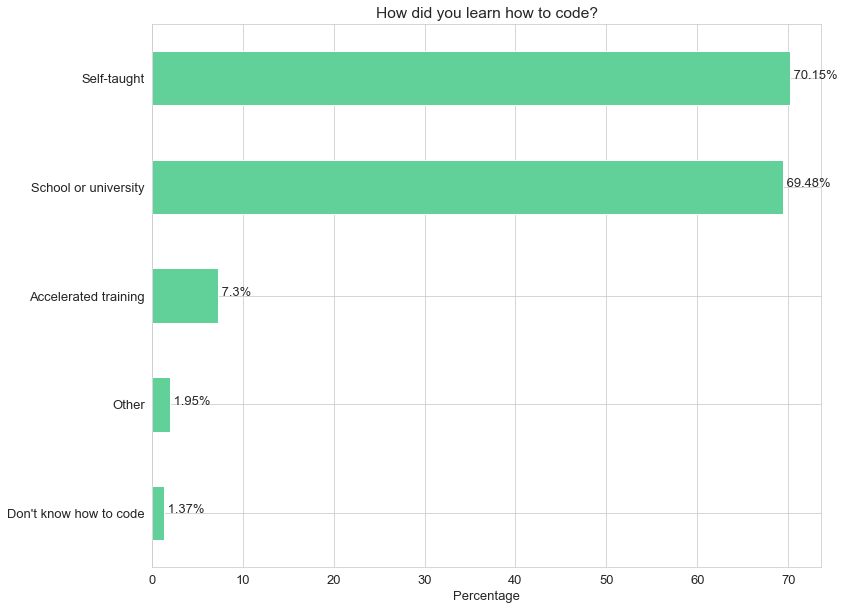

In [56]:
LearnCode_series=(lc1*100/len(LearnCode_df.index)).sort_values(ascending=True)
LearnCode_series.plot(kind="barh", figsize=(12,10), color="#61d199")
plt.title(ques_bank['q6LearnCodeUni'])
plt.xlabel('Percentage')
for index, value in enumerate(LearnCode_series):
    val=round(value,2)
    plt.text(value, index," "+str(val)+"%")
plt.xticks(rotation=0);

From the above barchart we can clearly observe that there are a large number of people have learnt to code by themselves. So, it's not necessary to go to a school or a university to learn how to code.

`matplotlib.pyplot.text(x,y,s)` adds the text s to the axes at location x, y in data coordinates.

### Q3: What were the most popular languages among men and among women in 2018?
To answer this, we can use the `q25Lang...` columns which tell us the languages the respondent knows. The respondents were allowed to choose multiple options here.

In [57]:
df_l1=pd.DataFrame(index=range(47))
df_l2=pd.DataFrame(index=range(47))
for col in list(df4.columns):
    if col[0:3]=='q25':
        df_l1[ques_bank[col]]=df4[col].copy()
        df_l1[ques_bank[col]].fillna(False,inplace=True)
        df_l1.replace(to_replace='Will Learn',value=False,inplace=True)
        df_l1.replace(to_replace='Know',value=True,inplace=True)
    elif col[0:3]=='q26':
        df_l2[ques_bank[col]]=df4[col].copy()
        df_l2[ques_bank[col]].fillna(False,inplace=True)
        df_l2.replace(to_replace='Will Learn',value=False,inplace=True)
        df_l2.replace(to_replace='Know',value=True,inplace=True)
        
df_l1['Other (please specify)']=df_l1['Other (please specify)'].isnull()
lang_series=df_l1.columns
df_l11=df_l1.copy()
df_l12=df_l2.copy()
df_l11['Gender']=df4['q3Gender'].copy()
df_l12['Gender']=df4['q3Gender'].copy()
df_l1.head(10)

,C,C++,Java,Python,Ruby,Javascript,C#,Go,Scala,Perl,Swift,Pascal,Clojure,PHP,Haskell,Lua,R,Rust,Typescript,Kotlin,Julia,Erlang,Ocaml,Other (please specify)
0,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False
1,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,True,False,False,True,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,True,True,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False
6,True,True,False,False,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False
7,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
8,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
9,True,False,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


`pandas.isnull()` detects missing values for an array-like object. This function takes a scalar or array-like object and indicates whether values are missing .

In [58]:
ques_bank['q25LangOther']

'Other (please specify)'

In [59]:
languages_percentages = df_l1.mean().sort_values(ascending=False) * 100
languages_percentages=languages_percentages[languages_percentages>0]

`pandas.DataFrame.mean()` returns the mean of the values for the requested axis.

`pandas.Series.sort_values()` sorts a Series by values in ascending or descending order by some criterion.

In [60]:
languages_male_percentages = df_l11[df_l11['Gender']=='Male'].mean().sort_values(ascending=False) * 100
languages_male_percentages=languages_male_percentages[languages_male_percentages>0]

In [61]:
languages_female_percentages = df_l11[df_l11['Gender']=='Female'].mean().sort_values(ascending=False) * 100
languages_female_percentages=languages_female_percentages[languages_female_percentages>0]

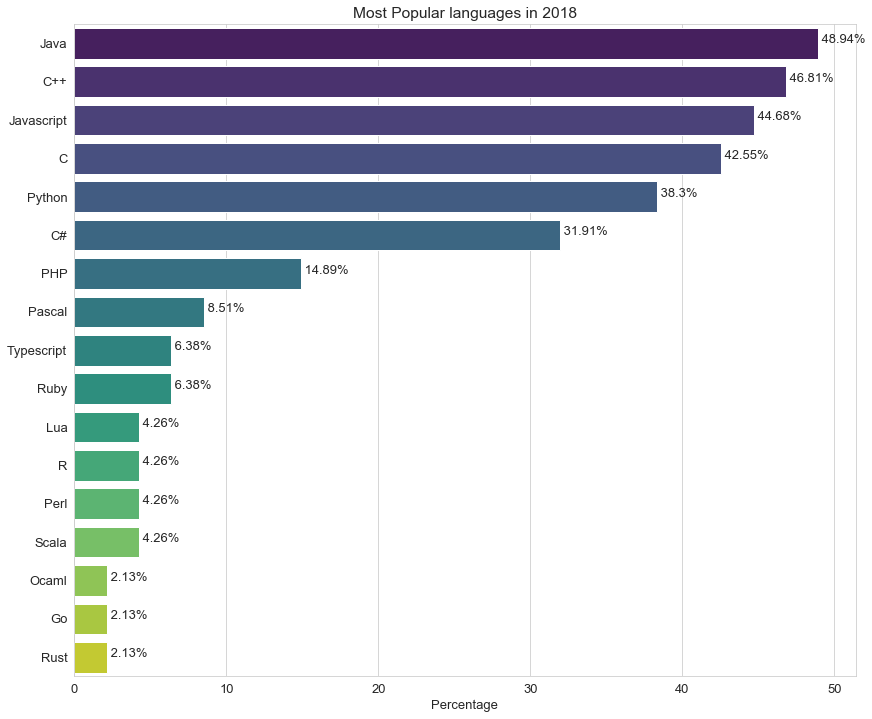

In [62]:
plt.figure(figsize=(14,12))
plt.title("Most Popular languages in 2018")
plt.xlabel("Percentage")
val=0
for index, value in enumerate(languages_percentages):
    val=round(value,2)
    plt.text(value, index," "+str(val)+"%")
sns.barplot(languages_percentages,languages_percentages.index,palette="viridis");

The most popular languages were Java and C++ in 2018. Other popular languages were JavaScript, C and Python.

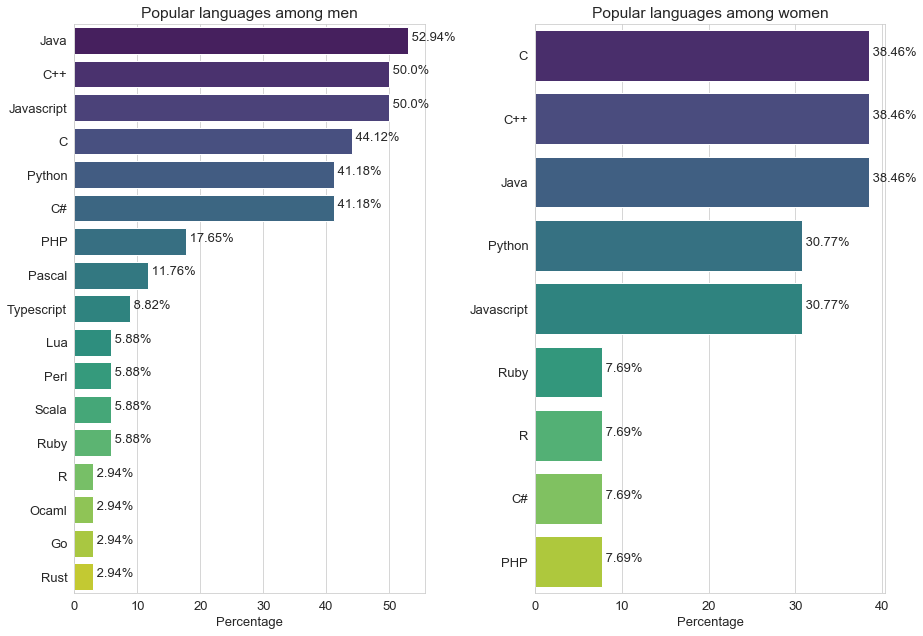

In [63]:
fig, axes = plt.subplots(1,2,figsize=(13,9))
sns.barplot(languages_male_percentages,languages_male_percentages.index,palette="viridis", ax=axes[0])
axes[0].set_xlabel('Percentage')
for index, value in enumerate(languages_male_percentages):
    val=round(value,2)
    axes[0].text(value, index," "+str(val)+"%")
axes[0].set_title('Popular languages among men');
sns.barplot(languages_female_percentages,languages_female_percentages.index,palette="viridis", ax=axes[1])
axes[1].set_xlabel('Percentage')
for index, value in enumerate(languages_female_percentages):
    val=round(value,2)
    axes[1].text(value, index," "+str(val)+"%")
axes[1].set_title('Popular languages among women');
plt.tight_layout(pad=1)

In 2018, Javascript was more popular than C among men while it was the opposite in the case of women. In general lesser number of women knew how to code in all these languages as compared to men.

### Q4: What were the the most popular frameworks among men and among women in 2018?
To answer this, we can use the `q26Frame...` columns which tell us the frameworks the respondent knows how to work with. The respondents were allowed to choose multiple options here.

In [64]:
df_l2.head()

,AngularJS,React,Vue.js,Ember,Backbone.js,Spring,JSF,Struts,Django,Pyramid,Ruby on Rails,Padrino,ASP,.NETCore,Node.js,ExpressJS,Meteor,Cocoa,React Native,Ruby Motion
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [65]:
framework_percentages = df_l2.mean().sort_values(ascending=False) * 100
framework_percentages=framework_percentages[framework_percentages>0]

In [66]:
framework_male_percentages = df_l12[df_l12['Gender']=='Male'].mean().sort_values(ascending=False) * 100
framework_male_percentages=framework_male_percentages[framework_male_percentages>0]

In [67]:
framework_female_percentages = df_l12[df_l12['Gender']=='Female'].mean().sort_values(ascending=False) * 100
framework_female_percentages=framework_female_percentages[framework_female_percentages>0]

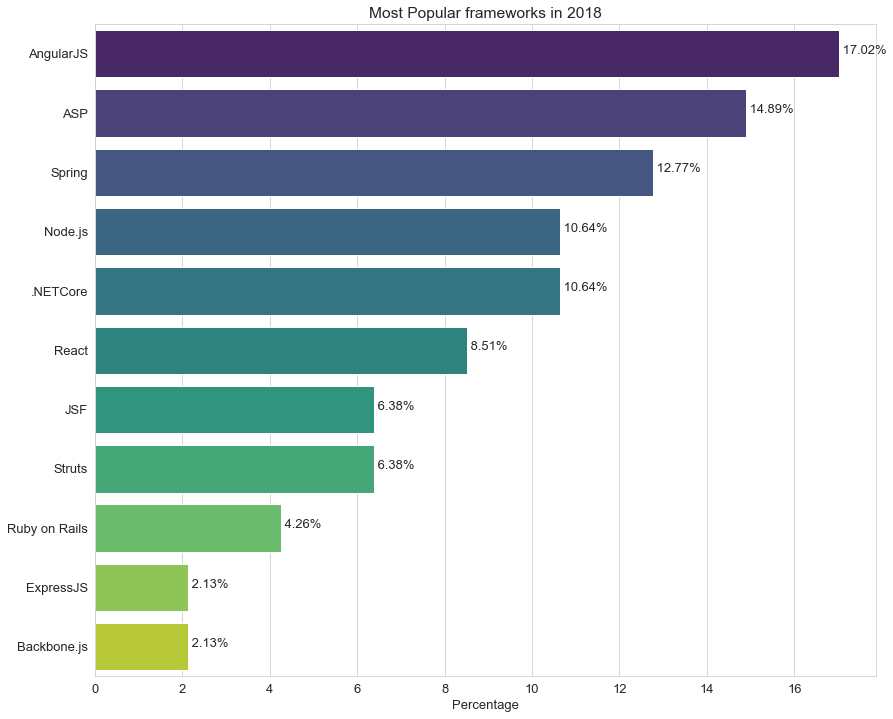

In [68]:
plt.figure(figsize=(14,12))
plt.title("Most Popular frameworks in 2018")
plt.xlabel("Percentage")
val=0
for index, value in enumerate(framework_percentages):
    val=round(value,2)
    plt.text(value, index," "+str(val)+"%")
sns.barplot(framework_percentages,framework_percentages.index,palette="viridis");

AngularJS was the most popular framework in 2018 while ASP took the second spot.

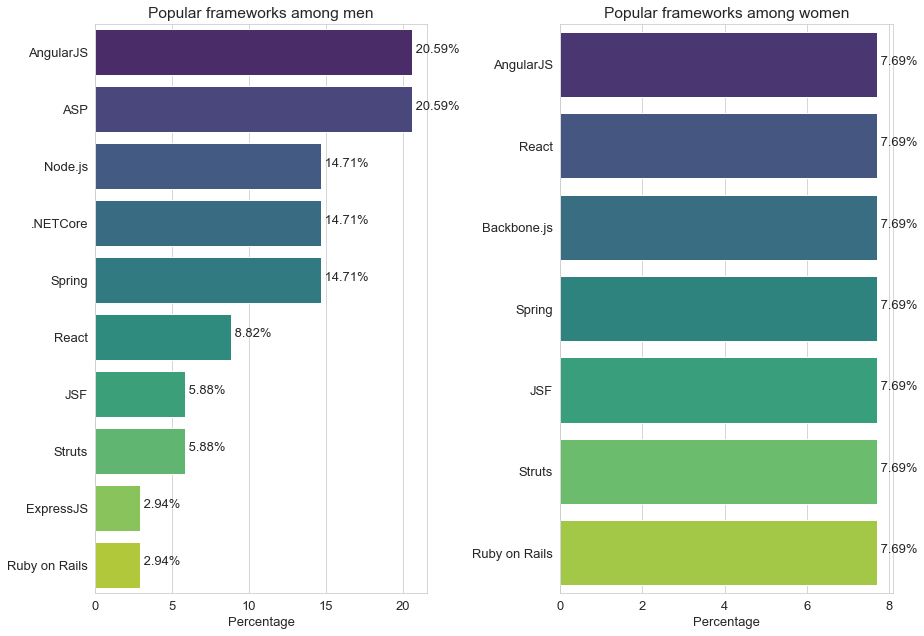

In [69]:
fig, axes = plt.subplots(1,2,figsize=(13,9))
sns.barplot(framework_male_percentages,framework_male_percentages.index,palette="viridis", ax=axes[0])
axes[0].set_xlabel('Percentage')
for index, value in enumerate(framework_male_percentages):
    val=round(value,2)
    axes[0].text(value, index," "+str(val)+"%")
axes[0].set_title('Popular frameworks among men');
sns.barplot(framework_female_percentages,framework_female_percentages.index,palette="viridis", ax=axes[1])
axes[1].set_xlabel('Percentage')
for index, value in enumerate(framework_female_percentages):
    val=round(value,2)
    axes[1].text(value, index," "+str(val)+"%")
axes[1].set_title('Popular frameworks among women');
plt.tight_layout(pad=1)

Most popular frameworks among men were AngularJS and ASP in 2018.
ASP, Node.js and .NETCore were popular among men but not among women, while Backbone.js was popular among women but not among men.

### Q5: How many people would like to recommend HackerRank to their friends?
Let's look at the `q32RecommendHackerRank` column to answer this question and plot a barplot to show the number of respondents who would like to recommend HackerRank.

In [70]:
survey_df

,CountryNumeric2,q1AgeBeginCoding,q3Gender,q5DegreeFocus,q9CurrentRole,q10Industry,q0010_other,q25LangC,q25LangCPlusPlus,q25LangJava,q25LangPython,q25LangRuby,q25LangJavascript,q25LangCSharp,q25LangGo,q25Scala,q25LangPerl,q25LangSwift,q25LangPascal,q25LangClojure,q25LangPHP,q25LangHaskell,q25LangLua,q25LangR,q25LangRust,q25LangTypescript,q25LangKotlin,q25LangJulia,q25LangErlang,q25LangOcaml,q25LangOther,q26FrameLearnAngularJS,q26FrameLearnReact,q26FrameLearnVueDotjs,q26FrameLearnEmber,q26FrameLearnBackboneDotjs,q26FrameLearnSpring,q26FrameLearnJSF,q26FrameLearnStruts,q26FrameLearnDjango,q26FrameLearnPyramid,q26FrameLearnRubyonRails,q26FrameLearnPadrino,q26FrameLearnASP,q26FrameLearnNetCore,q26FrameLearnNodeDotjs,q26FrameLearnExpressJS,q26FrameLearnMetero,q26FrameLearnCocoa,q26FrameLearnReactNative,q26FrameLearnRubyMotion,q26FrameLearnPadrino2,q26FrameLearnDjango2,q26FrameLearnPyramid2,q32RecommendHackerRank
0,South Korea,16 - 20 years old,Female,Computer Science,Student,NaN,student,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
1,Ukraine,16 - 20 years old,Male,"Other STEM (science, technology, eng...",Software Test Engineer,Financial Services,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
2,Malaysia,11 - 15 years old,Female,"Other STEM (science, technology, eng...",Student,Education,NaN,Will Learn,Will Learn,Will Learn,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
3,Curaçao,11 - 15 years old,Male,Computer Science,Student,NaN,student,NaN,Know,Will Learn,Will Learn,Know,Will Learn,Know,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
4,NaN,16 - 20 years old,Female,NaN,Front-end Developer,Technology,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,Will Learn,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,Yes
5,United States,41 - 50 years old,Male,Computer Science,Unknown,Technology,NaN,Will Learn,Will Learn,Know,Know,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Know,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,Will Learn,NaN,NaN,NaN,Yes
6,United States,16 - 20 years old,Male,Computer Science,Unemployed,Financial Services,NaN,Know,Know,Will Learn,Will Learn,NaN,Know,Will Learn,NaN,NaN,Know,NaN,Know,NaN,NaN,NaN,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Know,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
7,United States,16 - 20 years old,Male,"Other STEM (science, technology, eng...",Unknown,Education,NaN,NaN,Know,NaN,Know,NaN,Will Learn,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [71]:
recommendation=survey_df['q32RecommendHackerRank'].value_counts()*100/survey_df['q32RecommendHackerRank'].value_counts().sum()

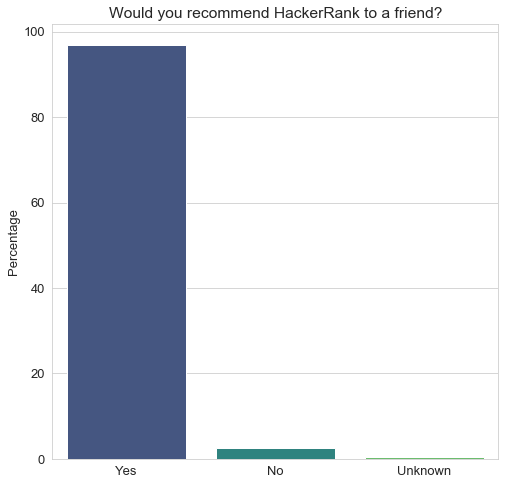

In [72]:
plt.figure(figsize=(8,8))
plt.title(ques_bank['q32RecommendHackerRank'])
ax=sns.barplot(recommendation.index,recommendation,palette="viridis");
ax.set(ylabel="Percentage");

In [73]:
recommendation['Yes']

96.97251790990407

Almost all the participants of the developer survey would like to recommend HackerRank to others.

Let us save and upload our work to Jovian before continuing.

In [74]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Attempting to save notebook..
[jovian] Updating notebook "nishumttl770/hackerrank-developer-survey-analysis" on https://jovian.ml/
[jovian] Uploading notebook..
[jovian] Capturing environment..
[jovian] Committed successfully! https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis


'https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis'

## Inferences and Conclusion
Here is a summary of few interesting inferences drawn from the survey:

- HackerRank is quite popular among students for programming. It is also useful for Developers and Software Engineers.

- The programming community is not as diverse as it can be, and although things are improving, we should take more efforts to support & encourage members of underrepresented communities - whether it is in terms of age, country, race, gender or otherwise.

- Although it's never too late to start learning and practicing programming professionally, it is better to start at a young age and most people do so.

- Most of the women who responded are working in the technology sector and education sector.

- Although most of the programmers hold a college degree, a large number of people did not have computer science as their major in college. So a computer science degree isn't compulsory for learning to code or building a career in programming.

- HackerRank is more popular in India as compared to other countries. It definitely has fewer responses from programmers in non-English speaking countries.

- There is no need to go to a school or university for learning programming, especially since there are many free resources & tutorials available online.

- Java & C++ were the most popular programming languages in 2018, closely followed by JavaScript & C. In general lesser number of women knew how to code in all these languages as compared to men.

- AngularJS was the most popular framework in 2018. ASP, Node.js and .NETCore were popular among men not women.

- Almost all people who participated in the survey would like to recommend HackerRank, which proves that HackerRank is a good platform for coding.

## References and Future Work

Here are some some useful reference links that helped in this project.

- [Pandas Library documentation](https://pandas.pydata.org/)
- [Matplotlib Library documentation](https://matplotlib.org/)
- [Seaborn Library documentation](https://seaborn.pydata.org/)
- [Analysing survey data](https://www.dataquest.io/blog/how-to-analyze-survey-data-python-beginner/)
- [Python Graph Library](https://python-graph-gallery.com/)
- [Markdown in jupyter notebook](https://www.datacamp.com/community/tutorials/markdown-in-jupyter-notebook?utm_source=adwords_ppc&utm_campaignid=1455363063&utm_adgroupid=65083631748&utm_device=c&utm_keyword=&utm_matchtype=b&utm_network=g&utm_adpostion=&utm_creative=332602034358&utm_targetid=dsa-429603003980&utm_loc_interest_ms=&utm_loc_physical_ms=9040183&gclid=Cj0KCQjwwuD7BRDBARIsAK_5YhXPXPcKyQtDEZ_U-cMkKVW-2iP6eOJwUmsrqGS8SjOnOSMZWtAoQMgaAm13EALw_wcB)

In [76]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Attempting to save notebook..
[jovian] Updating notebook "nishumttl770/hackerrank-developer-survey-analysis" on https://jovian.ml/
[jovian] Uploading notebook..
[jovian] Capturing environment..
[jovian] Committed successfully! https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis


'https://jovian.ml/nishumttl770/hackerrank-developer-survey-analysis'